In [1]:
import requests
import re
import pandas as pd
import numpy as np
import plotly.graph_objects as go
from io import StringIO
from datetime import date
from sklearn.ensemble import IsolationForest

# Ensure the Plotly renderer is set to JupyterLab
pio.renderers.default = 'jupyterlab'

# Define the UTDWR site ID
site_id = "10987"

# Get the current year
today = date.today()
current_year = int(today.strftime("%Y"))
start_year = 1990 # Adjust as needed
year=2024

# Initialize an empty dataframe to store all years
df_all_years = pd.DataFrame()

#for year in range(start_year, current_year + 1):  # Loop over years
#try:
    # Construct the URL
URL = f"https://www.waterrights.utah.gov/cgi-bin/dvrtview.exe?STATION_ID={site_id}&RECORD_YEAR={year}&Modinfo=Daily_Comma"

rr = requests.get(URL)
temp = StringIO(rr.text)
lines = temp.readlines()

# Extract the actual data URL
URL_end = next((re.findall('"([^"]*)"', line)[0] for line in lines if line.startswith("Daily comma delimited")), None)

# === FLAGGING CRITERIA === #
df_all_years['FLAG_NEGATIVE'] = df_all_years['DISCHARGE'] < 0
df_all_years['FLAG_ZERO'] = df_all_years['DISCHARGE'] == 0

# Rate of Change (RoC)
df_all_years['RoC'] = df_all_years['DISCHARGE'].diff().abs()
df_all_years['RoC'].fillna(0, inplace=True)

roc_threshold = df_all_years['RoC'].quantile(0.95)
df_all_years['FLAG_RoC'] = df_all_years['RoC'] > roc_threshold

# Debugging: Print RoC threshold
print(f"Rate of Change (RoC) 95th percentile threshold: {roc_threshold}")
print(f"Total FLAG_RoC points: {df_all_years['FLAG_RoC'].sum()}")

# IQR Outlier Detection
Q1 = df_all_years['DISCHARGE'].quantile(0.25)
Q3 = df_all_years['DISCHARGE'].quantile(0.75)
IQR = Q3 - Q1
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR
df_all_years['FLAG_IQR'] = (df_all_years['DISCHARGE'] < lower_bound) | (df_all_years['DISCHARGE'] > upper_bound)

# Debugging: Print number of flagged IQR values
print(f"Total FLAG_IQR points: {df_all_years['FLAG_IQR'].sum()}")

# Flag repeated values (≥5 consecutive days)
df_all_years['FLAG_REPEATED'] = (
    df_all_years['DISCHARGE']
    .groupby((df_all_years['DISCHARGE'] != df_all_years['DISCHARGE'].shift()).cumsum())
    .transform('count') >= 5
)

# Isolation Forest Outlier Detection
df_clean = df_all_years.dropna(subset=['DISCHARGE'])
model = IsolationForest(contamination=0.05, random_state=42)
df_clean['OUTLIER_IF'] = model.fit_predict(df_clean[['DISCHARGE']])
df_all_years['OUTLIER_IF'] = False
df_all_years.loc[df_clean.index, 'OUTLIER_IF'] = df_clean['OUTLIER_IF'] == -1

# Debugging: Print total outliers detected
print(f"Total Isolation Forest outliers: {df_all_years['OUTLIER_IF'].sum()}")

# Combine all flag conditions
df_all_years['FLAGGED'] = df_all_years[['FLAG_NEGATIVE', 'FLAG_ZERO', 'FLAG_REPEATED', 'FLAG_IQR', 'OUTLIER_IF', 'FLAG_RoC']].any(axis=1)

# Ensure flagged dataset isn't empty
df_flagged = df_all_years[df_all_years['FLAGGED']]
print(f"Total flagged points: {len(df_flagged)}")

# === INTERACTIVE PLOTS === #

fig2 = go.Figure()

# Background Line (Mean Daily Discharge) without connecting missing data
fig2.add_trace(go.Scatter(
    x=df_all_years['DATE'], y=df_all_years['DISCHARGE'],
    mode='lines',
    line=dict(color='lightgray', width=1.5),
    name='Mean Daily Discharge',
    connectgaps=False  # Prevents drawing lines over missing data
))

# Define custom legend names and colors
flag_colors = {
    'FLAG_NEGATIVE': ('red', 'Negative (-)'),
    'FLAG_ZERO': ('blue', 'Value = 0'),
    'FLAG_REPEATED': ('green', 'Repeated (≥5 days)'),
    'FLAG_IQR': ('orange', 'IQR Outlier'),
    'OUTLIER_IF': ('purple', 'Isolation Forest Outlier'),
    'FLAG_RoC': ('black', 'RoC Outlier')
}

# Add flagged points to the plot
for flag, (color, legend_name) in flag_colors.items():
    subset = df_flagged[df_flagged[flag]]
    
    # Debugging: Print number of flagged points per category
    print(f"Total {legend_name} flagged points: {len(subset)}")
    
    if not subset.empty:
        fig2.add_trace(go.Scatter(
            x=subset['DATE'], y=subset['DISCHARGE'],
            mode='markers',
            marker=dict(color=color, size=6),
            name=legend_name
        ))

# Update layout
fig2.update_layout(
    title="Flagged Data Points for Joe's Reservoir Release (CFS)",
    xaxis_title="Date",
    yaxis_title="Discharge (CFS)",
    legend_title="Flags",
    template="plotly_white",
    width=1400,
    height=700
)

fig2.show()

NameError: name 'pio' is not defined

C:\Users\pbenko\AppData\Local\Temp\1\ipykernel_8912\1052191831.py:63: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.





Total flagged points: 56322


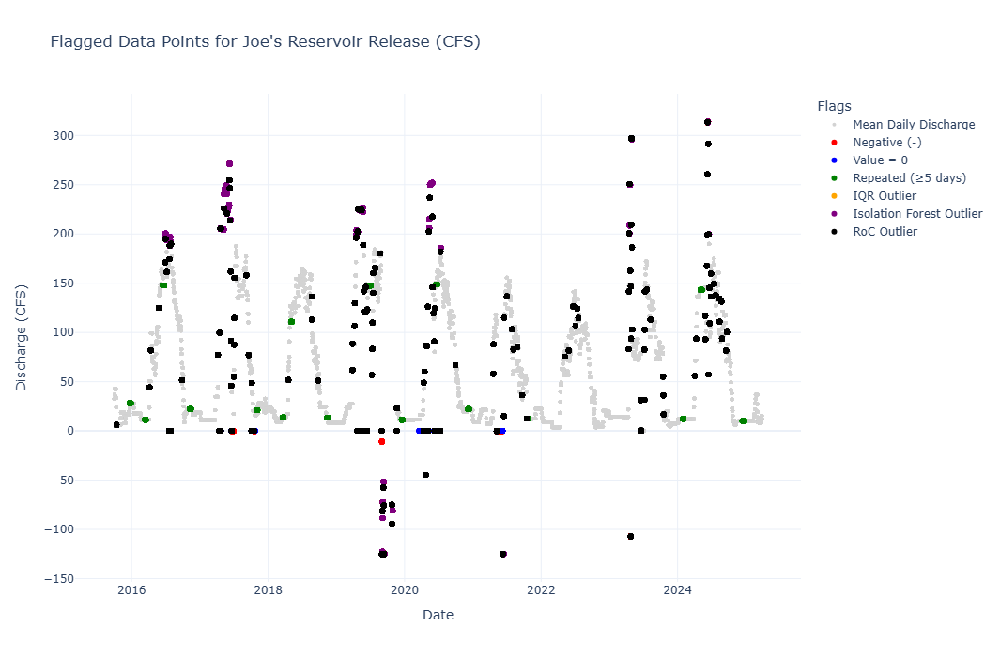

In [9]:
import requests
import re
import pandas as pd
import numpy as np
import plotly.graph_objects as go
from io import StringIO
from datetime import date
from sklearn.ensemble import IsolationForest

# Define the UTDWR site ID
site_id = "10987"

# Get the current year
today = date.today()
current_year = int(today.strftime("%Y"))
start_year = 1900
end_year = 2025

df_all_years = pd.DataFrame()

for year in range(start_year, current_year + 1):
    try:
        URL = f"https://www.waterrights.utah.gov/cgi-bin/dvrtview.exe?STATION_ID={site_id}&RECORD_YEAR={year}&Modinfo=Daily_Comma"
        rr = requests.get(URL)
        temp = StringIO(rr.text)
        lines = temp.readlines()

        # Extract the actual data URL
        URL_end = next((re.findall('"([^"]*)"', line)[0] for line in lines if "Daily comma delimited" in line), None)

        if not URL_end:
            continue

        URL_full = f"https://www.waterrights.utah.gov{URL_end}"
        rrr = requests.get(URL_full)
        df = pd.read_csv(StringIO(rrr.text))

        if df.empty:
            continue

        df.columns = ["year", "month", "day", "DISCHARGE"]
        df["DATE"] = pd.to_datetime(df[['year', 'month', 'day']])
        df.drop(columns=["year", "month", "day"], inplace=True)
        df_all_years = pd.concat([df_all_years, df], ignore_index=True)

    except Exception as e:
        print(f"Error processing year {year}: {e}")

# Ensure we have data
if df_all_years.empty:
    print("No data collected. Exiting.")
    exit()

# Remove rows with missing discharge values (NaN)
df_all_years.dropna(subset=['DISCHARGE'], inplace=True)

# === FLAGGING CRITERIA === #
df_all_years['FLAG_NEGATIVE'] = df_all_years['DISCHARGE'] < 0
df_all_years['FLAG_ZERO'] = df_all_years['DISCHARGE'] == 0

# Rate of Change (RoC)
df_all_years['RoC'] = df_all_years['DISCHARGE'].diff().abs()
df_all_years['RoC'].fillna(0, inplace=True)

roc_threshold = df_all_years['RoC'].quantile(0.95)
df_all_years['FLAG_RoC'] = df_all_years['RoC'] > roc_threshold

# IQR Outlier Detection
Q1 = df_all_years['DISCHARGE'].quantile(0.25)
Q3 = df_all_years['DISCHARGE'].quantile(0.75)
IQR = Q3 - Q1
lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR
df_all_years['FLAG_IQR'] = (df_all_years['DISCHARGE'] < lower_bound) | (df_all_years['DISCHARGE'] > upper_bound)

# Flag repeated values (≥5 consecutive days)
df_all_years['FLAG_REPEATED'] = (
    df_all_years['DISCHARGE']
    .groupby((df_all_years['DISCHARGE'] != df_all_years['DISCHARGE'].shift()).cumsum())
    .transform('count') >= 5
)

# Isolation Forest Outlier Detection (Applied only to the cleaned data)
df_clean = df_all_years.copy()
model = IsolationForest(contamination=0.05, random_state=42)
df_clean['OUTLIER_IF'] = model.fit_predict(df_clean[['DISCHARGE']])
df_all_years['OUTLIER_IF'] = False
df_all_years.loc[df_clean.index, 'OUTLIER_IF'] = df_clean['OUTLIER_IF'] == -1

# Combine all flag conditions
df_all_years['FLAGGED'] = df_all_years[['FLAG_NEGATIVE', 'FLAG_ZERO', 'FLAG_REPEATED', 'FLAG_IQR', 'OUTLIER_IF', 'FLAG_RoC']].any(axis=1)

# Ensure flagged dataset isn't empty
df_flagged = df_all_years[df_all_years['FLAGGED']]
print(f"Total flagged points: {len(df_flagged)}")

# === INTERACTIVE PLOTS === #

fig2 = go.Figure()

# Background Line (Mean Daily Discharge) without connecting missing data
fig2.add_trace(go.Scatter(
    x=df_all_years['DATE'], y=df_all_years['DISCHARGE'],
    mode='markers',  # Change to 'markers' for scatter plot
    marker=dict(color='lightgray', size=4),  # Adjusted size for scatter
    name='Mean Daily Discharge',
))

# Define custom legend names and colors
flag_colors = {
    'FLAG_NEGATIVE': ('red', 'Negative (-)'),
    'FLAG_ZERO': ('blue', 'Value = 0'),
    'FLAG_REPEATED': ('green', 'Repeated (≥5 days)'),
    'FLAG_IQR': ('orange', 'IQR Outlier'),
    'OUTLIER_IF': ('purple', 'Isolation Forest Outlier'),
    'FLAG_RoC': ('black', 'RoC Outlier')
}

# Add flagged points to the plot
for flag, (color, legend_name) in flag_colors.items():
    subset = df_flagged[df_flagged[flag]]
    
    if not subset.empty:
        fig2.add_trace(go.Scatter(
            x=subset['DATE'], y=subset['DISCHARGE'],
            mode='markers',
            marker=dict(color=color, size=6),
            name=legend_name
        ))

# Update layout
fig2.update_layout(
    title="Flagged Data Points for Joe's Reservoir Release (CFS)",
    xaxis_title="Date",
    yaxis_title="Discharge (CFS)",
    legend_title="Flags",
    template="plotly_white",
    width=1400,
    height=700
)

fig2.show()
